# LAB 3 -  Gaussian beams

| Name | Surname | ID Number |
|------|---------|---------------------|
| Andrea | Turci | 2106724 |

In [1]:
import gaussian_beam_functions as gbf

**Load image, denoise and zoom**

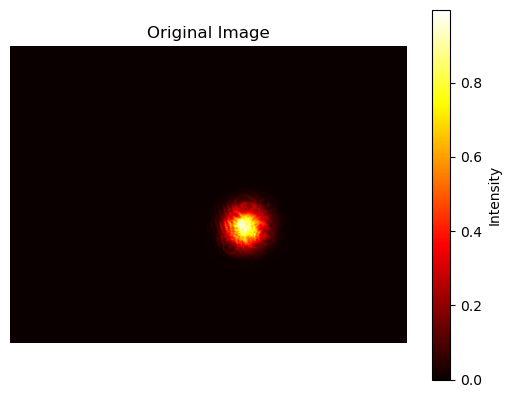

In [2]:
filename = "./Data/Gaussian beam/12.5cm.bmp"

# Load and visualize
image = gbf.extract_red(filename)
gbf.visualize_image(image, "Original Image")

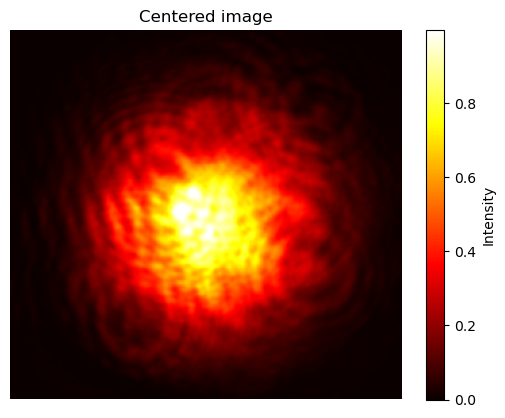

In [3]:
# Denoise and zoom
image_zoomed = gbf.extract_red(filename, noise=True, cz=True)
gbf.visualize_image(image_zoomed, "Centered image")

In [4]:
# Visualize 3D
gbf.visualize_image_3D(image_zoomed, title="Red Channel - 3D interactive plot")

**Gaussian fit**

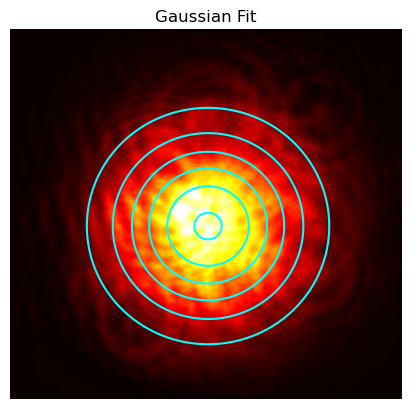

In [5]:
# Fit 2D - gaussian
params = gbf.fit_gaussian(image_zoomed)
gbf.visualize_fit(image_zoomed, params)

In [6]:
# Beam parameters
beam_params = gbf.calculate_beam_parameters(params)
print("Beam Parameters:", beam_params)

Beam Parameters: {'Peak Intensity': 0.9211273506575632, 'Center (x, y)': (146.32128950660675, 145.28431649858166), 'Beam Width (sigma_x)': 47.1523196793264, 'Beam Width (sigma_y)': 45.98965240856122, 'Ellipticity (sigma_x / sigma_y)': 1.0252810623667326}


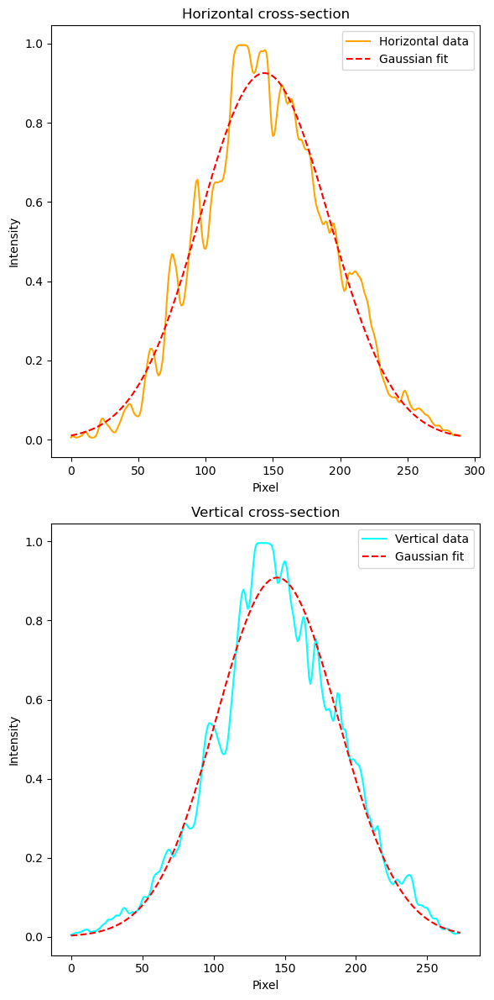

Horizontal Fit Parameters: Amplitude = 0.93, Mean = 143.67, Std Dev = 47.92
Vertical Fit Parameters: Amplitude = 0.91, Mean = 144.69, Std Dev = 42.88


(0.03306174262772809, 0.029586964374128968)

In [7]:
# Fit cross sections with 1D gaussian
gbf.cross_sections(image_zoomed, plot=True, verbose=True)

In [8]:
# Total power
total_power = gbf.calculate_total_power(image_zoomed)
print("Total Power:", total_power)

Total Power: 12572.812477870795


**Fourier analysis**

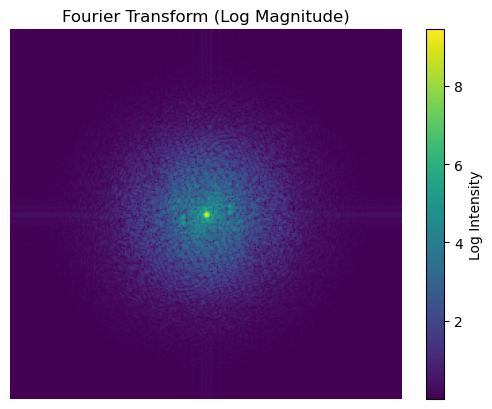

In [9]:
# Fourier analysis
fourier_magnitude = gbf.fourier_analysis(image_zoomed)

**Beam radius**

In [10]:
directory_path = "./Data/Gaussian beam"

images, z_positions = gbf.extract_images(directory_path)

Optimal parameters:
  W0: 0.0296 ± 0.0012 [cm]
  zR: 45.9945 ± 2.1392 [cm]


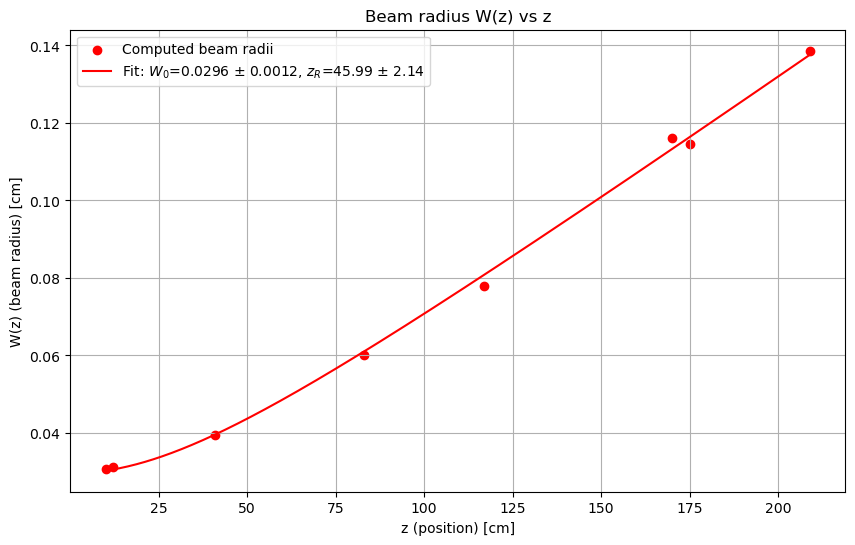

In [11]:
popt, pcov = gbf.fit_beam_radii(images, z_positions, lens=False, plot=True)

**Beam radius with lens**

In [12]:
directory_path = "./Data/Lens (dist=34cm)"

images, z_positions = gbf.extract_images(directory_path)

Optimal parameters:
  W0: 0.0055 ± 0.0011 [cm]
  zR: -1.6812 ± 0.3965 [cm]
  f: 10.4809 ± 0.1897 [cm]


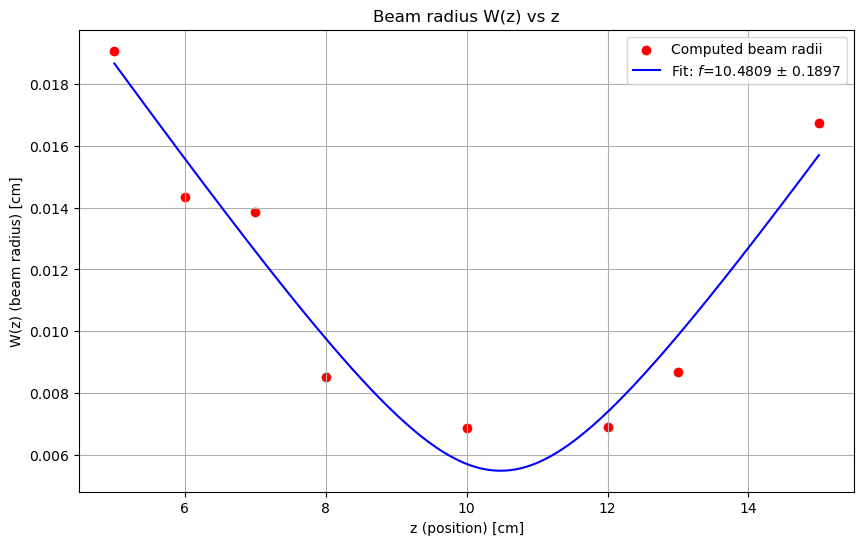

In [13]:
popt, pcov = gbf.fit_beam_radii(images, z_positions, lens=True, plot=True)

**Diffraction**

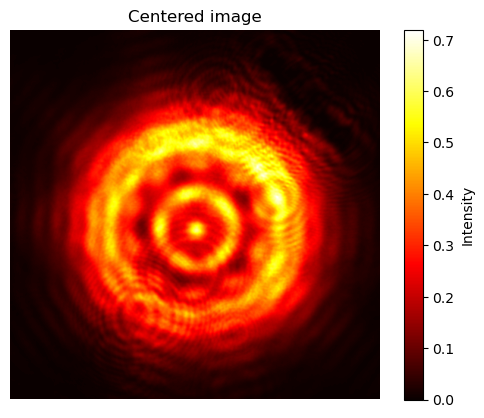

In [14]:
filename = "./Data/Fresnel diffraction (old data)/15beamexp.bmp"
# Denoise and zoom
image_zoomed = gbf.extract_red(filename, noise=True, cz=True)
gbf.visualize_image(image_zoomed, "Centered image")

In [15]:
# Visualize 3D
gbf.visualize_image_3D(image_zoomed, title="Red Channel - 3D interactive plot")

Optimal parameters:
  a: 0.0879 ± 0.0023 [cm]


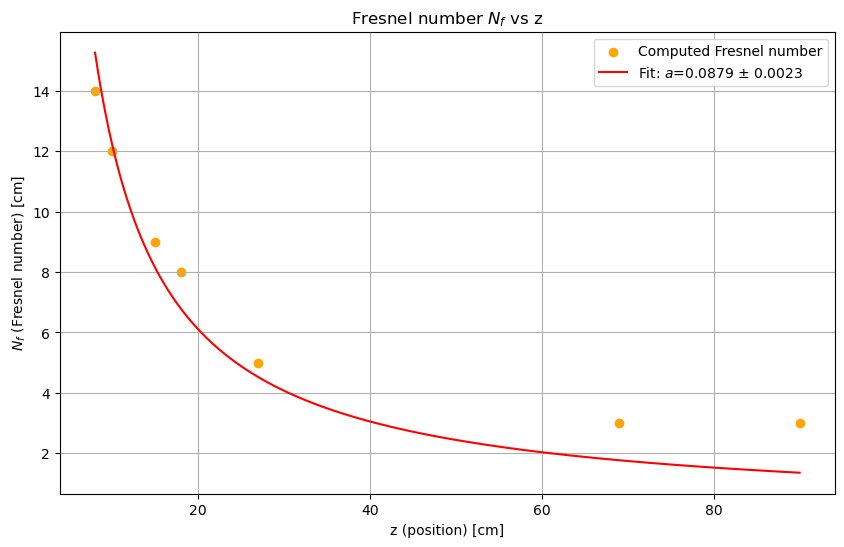

In [16]:
fringes = [14, 12, 9, 8, 5, 3, 3]
z_positions = [8, 10, 15, 18, 27, 69, 90]

popt, pcov = gbf.fit_diffraction(fringes, z_positions, plot=True)